# Demo for Talk

In [5]:
# Run this cell and paste the API key in the prompt
import os
import configparser
# Create a ConfigParser object
config = configparser.ConfigParser()

# Read the configuration file
config.read('.config.ini')
os.environ['GOOGLE_API_KEY'] = config.get('GoogleGeminiAPI', 'Google_Gemini_API_KEY')

os.environ['LANGCHAIN_TRACING_V2'] = config.get('LangChain', 'LANGCHAIN_TRACING_V2')
os.environ['LANGCHAIN_ENDPOINT'] = config.get('LangChain', 'LANGCHAIN_ENDPOINT')
os.environ['LANGCHAIN_API_KEY'] = config.get('LangChain', 'LANGCHAIN_API_KEY')
os.environ['USER_AGENT'] = config.get('LangChain', 'USER_AGENT')

os.environ['OPENAI_API_KEY'] = config.get('OpenAI', 'OPENAI_API_KEY')

# LLMs (one-step prompting)

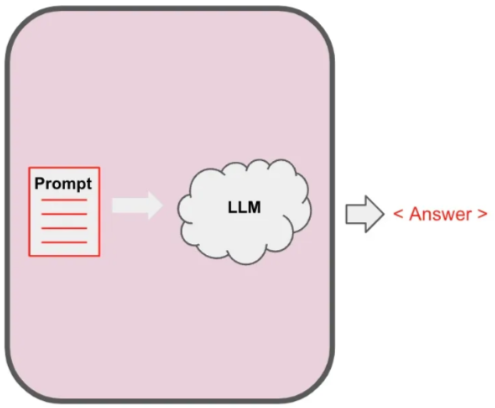

In [ ]:
PROJECT_ID = "gen-lang-client-0051197935"  # @param {type:"string"}
LOCATION = "us-central1"  # @param {type:"string"}

import vertexai
vertexai.init(project=PROJECT_ID, location=LOCATION)

In [ ]:
import google.generativeai as genai
import os

genai.configure(api_key=config.get('GoogleGeminiAPI', 'Google_Gemini_API_KEY'))
model = genai.GenerativeModel('gemini-1.5-flash')


response = model.generate_content("Write a potry for beautiful sunshine")
print(response.text)

The sun, a painter, strokes the sky,
With hues of gold, where clouds drift by.
A gentle warmth, a loving grace,
Illuminates each time and place.

On fields of green, a golden sheen,
A diamond dust, a vibrant scene.
The trees stand tall, in sunlit dress,
Their leafy boughs, a soft caress.

A river gleams, a molten thread,
Reflecting light, on its smooth bed.
The flowers bloom, in joyous pride,
Their petals kissed, by sun's warm tide.

And shadows dance, in playful flight,
Chasing darkness, with pure delight.
The world awakes, refreshed and new,
Bathed in the sun, a brilliant hue.

So let us bask, in golden rays,
And feel the warmth, of sunlit days.
For in its light, a joy we find,
A peace of mind, for heart and mind.



## Gemini capabilities

In [10]:
from vertexai.generative_models import GenerativeModel, Image, Part

multimodal_model = GenerativeModel("gemini-1.5-pro")
multimodal_model_flash = GenerativeModel("gemini-1.5-flash")

In [11]:
# Helper functions 

import http.client
import typing
import urllib.request

from IPython.core.interactiveshell import InteractiveShell
import IPython.display

InteractiveShell.ast_node_interactivity = "all"


def get_image_bytes_from_url(image_url: str) -> bytes:
    with urllib.request.urlopen(image_url) as response:
        response = typing.cast(http.client.HTTPResponse, response)
        image_bytes = response.read()
    return image_bytes


def load_image_from_url(image_url: str) -> Image:
    image_bytes = get_image_bytes_from_url(image_url)
    return Image.from_bytes(image_bytes)


def display_content_as_video(content: str | Image | Part):
    if not isinstance(content, Part):
        return False
    part = typing.cast(Part, content)
    file_path = part.file_data.file_uri.removeprefix("gs://")
    video_url = f"https://storage.googleapis.com/{file_path}"
    IPython.display.display(IPython.display.Video(video_url, width=350))

In [12]:
question = "What is the average weather in Mountain View, CA in the middle of May?"
prompt = """
Considering the weather, please provide some outfit suggestions.

Give examples for the daytime and the evening.
"""

contents = [question, prompt]
response = multimodal_model.generate_content(contents)
print(response.text)

/home/mb600l/conda_env/langchain_3.11/lib/python3.11/site-packages/google/auth/_default.py:76: UserWarning: Your application has authenticated using end user credentials from Google Cloud SDK without a quota project. You might receive a "quota exceeded" or "API not enabled" error. See the following page for troubleshooting: https://cloud.google.com/docs/authentication/adc-troubleshooting/user-creds. 
  warnings.warn(_CLOUD_SDK_CREDENTIALS_WARNING)


## Mountain View Weather in Mid-May

Mountain View, CA, enjoys beautiful weather in mid-May. Expect sunny days with average high temperatures around **72°F (22°C)** and comfortable lows around **52°F (11°C)**.  Rain is rare during this time.

**Outfit Suggestions:**

**Daytime:**

* **Comfortable and Casual:**  The weather is perfect for exploring, so opt for a t-shirt or tank top paired with jeans, shorts, or a skirt. A sundress or a romper would also be a great choice.
    * **Example:** A white linen shirt with denim shorts and sandals. 
* **Layers are Key:** While it's generally warm, the mornings and evenings can be cooler. Pack a light jacket, cardigan, or sweater for layering.
    * **Example:** A light cotton cardigan to throw over a sleeveless top.
* **Sun Protection:** Don't forget your sunglasses, a hat, and sunscreen to protect yourself from the California sun!
    * **Example:** A wide-brimmed straw hat and sunglasses.

**Evening:**

* **Slightly Dressier:** As the tempera

In [13]:
pdf_file_uri = "gs://cloud-samples-data/generative-ai/pdf/2403.05530.pdf"
pdf_file = Part.from_uri(pdf_file_uri, mime_type="application/pdf")

prompt = "How many tokens can the model process?"

contents = [pdf_file, prompt]

response = multimodal_model.generate_content(contents)
print(response.text)

The document states that Gemini 1.5 Pro can process up to at least **10 million tokens**. 



### Document Summarization

In [14]:
prompt = """
  You are a professional document summarization specialist.
  Please summarize the given document.
"""

contents = [pdf_file, prompt]

response = multimodal_model.generate_content(contents)
print(response.text)

The report presents Gemini 1.5 Pro, a new multimodal AI model developed by Google. 

**Key features of Gemini 1.5 Pro:**

* **Multimodal:**  Processes text, images, video, and audio.
* **Long-context understanding:** Can process inputs up to 10 million tokens, a significant leap over previous models.
* **High performance:** Performs comparably to the state-of-the-art Gemini 1.0 Ultra while using less compute and being more efficient to serve.
* **Near-perfect recall:** Achieves near-perfect recall on long-context retrieval tasks across all modalities.
* **In-context learning:** Can learn new tasks, such as language translation, from single sets of provided documentation.

**Key findings from the evaluations:**

* **Long-context capabilities:** Gemini 1.5 Pro exhibits continued improvement in predictive performance and near-perfect recall on synthetic retrieval tasks with context lengths up to 10 million tokens.
* **Core capabilities:**  Despite its long-context focus, Gemini 1.5 Pro sh

In [15]:
pdf_file_uri = "gs://cloud-samples-data/generative-ai/pdf/2403.05530.pdf"
pdf_file = Part.from_uri(pdf_file_uri, mime_type="application/pdf")

prompt = "How many tokens can the model process?"

contents = [pdf_file, prompt]

response = multimodal_model.generate_content(contents)
print(response.text)

The text states that Gemini 1.5 Pro can handle up to at least **10 million tokens**. 



In [16]:
prompt = """
  You are a professional document summarization specialist.
  Please summarize the given document.
"""

contents = [pdf_file, prompt]

response = multimodal_model.generate_content(contents)
print(response.text)

The document presents Gemini 1.5 Pro, a new multimodal model from Google DeepMind. It excels in understanding information from extensive contexts, including long documents, videos, and audio, surpassing existing models' capabilities by a significant margin.

Here are the key takeaways:

* **Unprecedented Context Length:** Gemini 1.5 Pro can process up to 10 million tokens, allowing it to handle entire books, hours of video, and days of audio recordings. This is a major leap beyond the current limit of 200k tokens offered by models like Claude 2.1.
* **Multimodal Understanding:** Gemini 1.5 Pro is natively multimodal, supporting the processing of combined text, image, video, and audio inputs in a single sequence.
* **Near-Perfect Recall:** Evaluations show near-perfect recall capabilities for retrieving specific information hidden within vast amounts of data across all modalities.
* **In-Context Learning:** Gemini 1.5 Pro exhibits remarkable in-context learning abilities, demonstrated b

### Image Understanding across many Images

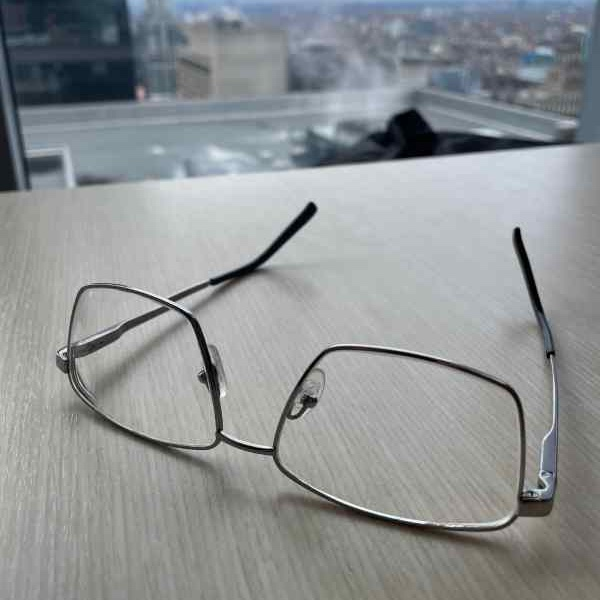

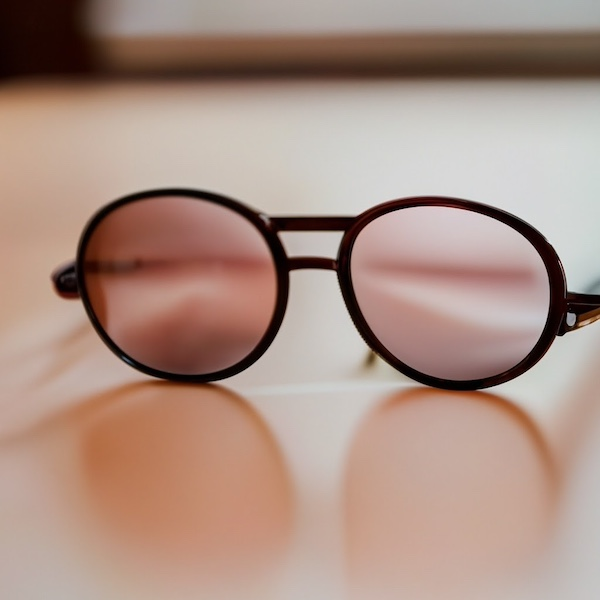

For an oval face shape, both of these glasses styles could work well, but for different reasons:

**The square/rectangular glasses:**

* **Why they work for oval faces:**  Oval faces are considered balanced, meaning they can pull off a wider variety of styles. Angular frames like these can add definition and contrast to the natural curves of an oval face.
* **Things to consider:**
    * **Size matters:** Ensure the frames are proportional to your face. Oversized squares can overwhelm, while very small ones might look out of place.
    * **Softening the angles:** Look for frames with slightly rounded edges to complement the face's natural curves. 

**The round glasses:**

* **Why they work for oval faces:**  The classic round shape can provide a nice contrast to the face's length, adding a touch of softness and vintage charm.
* **Things to consider:**
    * **Frame width:** Look for round frames that extend slightly beyond the widest part of your face to create balance.
    * **Frame th

In [17]:
image_glasses1_url = "https://storage.googleapis.com/github-repo/img/gemini/multimodality_usecases_overview/glasses1.jpg"
image_glasses2_url = "https://storage.googleapis.com/github-repo/img/gemini/multimodality_usecases_overview/glasses2.jpg"
image_glasses1 = load_image_from_url(image_glasses1_url)
image_glasses2 = load_image_from_url(image_glasses2_url)

prompt = """
I have an oval face. Given my face shape, which glasses would be more suitable?

Explain how you reached this decision.
Provide your recommendation based on my face shape, and please give an explanation for each.
"""

IPython.display.Image(image_glasses1_url, width=150)
IPython.display.Image(image_glasses2_url, width=150)

contents = [prompt, image_glasses1, image_glasses2]
responses = multimodal_model.generate_content(contents)
print(responses.text)

### Video Description

In [18]:
prompt = """
What is shown in this video?
Where should I go to see it?
What are the top 5 places in the world that look like this?
"""
video = Part.from_uri(
    uri="gs://github-repo/img/gemini/multimodality_usecases_overview/mediterraneansea.mp4",
    mime_type="video/mp4",
)
contents = [prompt, video]

responses = multimodal_model.generate_content(contents)

display_content_as_video(video)
display(IPython.display.Markdown(responses.text))

The video shows the beautiful Antalya old harbor in Turkey.

The top five places that look like this are: 

1. Antalya Old Harbor, Turkey
2. Positano, Italy
3. Dubrovnik, Croatia
4. Santorini, Greece
5. Amalfi Coast, Italy


### Audio Understanding

In [19]:
audio_file_path = "cloud-samples-data/generative-ai/audio/pixel.mp3"
audio_file_uri = f"gs://{audio_file_path}"
audio_file_url = f"https://storage.googleapis.com/{audio_file_path}"

IPython.display.Audio(audio_file_url)

In [20]:
prompt = """
  Please provide a short summary and title for the audio.
  Provide chapter titles, be concise and short, no need to provide chapter summaries.
  Provide each of the chapter titles in a numbered list.
  Do not make up any information that is not part of the audio and do not be verbose.
"""

audio_file = Part.from_uri(audio_file_uri, mime_type="audio/mpeg")
contents = [audio_file, prompt]

response = multimodal_model.generate_content(contents)
IPython.display.Markdown(response.text)

## Title: Pixel Feature Drops: Always Getting Better

### Chapters:

1.  Transformative Features
2.  The Importance of Feature Drops
3.  January Feature Drop Highlights
4.  New for Pixel Watch in March
5.  New for Pixel Phones in March
6.  Updates for the Rest of the Pixel Family
7.  Deciding on New Features
8.  The Impact of User Feedback
9.  March Feature Drop Release Date
10.  Memorable Feature Drops
11.  A Look at the Relax App 


In [21]:
prompt = """
    Can you transcribe this interview, in the format of timecode, speaker, caption.
    Use speaker A, speaker B, etc. to identify the speakers.
    Please provide each piece of information on a separate bullet point.
"""

audio_file = Part.from_uri(audio_file_uri, mime_type="audio/mpeg")
contents = [audio_file, prompt]

responses = multimodal_model_flash.generate_content(contents)

IPython.display.Markdown(responses.text)

Okay, here's a transcription of the interview:

* 0:00  Speaker A  Your devices are getting better over time, and so we think about it across the entire portfolio, from phones to watch to buds to tablet. We get really excited about how we can tell a joint narrative across everything. 
* 0:14 Speaker B  Welcome to the Made by Google Podcast, where we meet the people who work on the Google products you love. Here's your host, Rashid Finch. Today, we're talking to Aisha Sharif and De Carlos Love. They're both product managers for various Pixel devices, and work on something that all Pixel owners love: The Pixel Feature Drops. This is the Made by Google Podcast. Aisha, which feature on your Pixel phone has been most transformative in your own life? 
* 0:44 Speaker A  So many features! I am a singer, so I actually think recorded transcription has been incredible, because before I would record songs, I'd just like freestyle them, record them, type them up, but now with transcription, it works so well, even deciphering lyrics that are jumbled. I think that's huge.
* 1:07 Speaker B  Amazing. De Carlos, same question to you, but for Pixel Watch, of course. Long-time listeners will know you work on Pixel Watch. What has been the most transformative feature in your own life on Pixel Watch? 
* 1:24 Speaker C  I work on the fitness experiences, and so for me it's definitely the ability to track my heart rate, but specifically around the different heart rate targets and zone features that we've released. For me, it's been super helpful. My background is in more football, track and field, in terms of what I've done before. And so using the heart rate features to really help me understand that I shouldn't be going as hard when I'm running, you know, a leisurely 2 or 3 miles, and helping me really tone that down a bit. It's actually been pretty transformative for me to see how things like my resting heart rate have changed due to that feature.
* 2:03 Speaker B  Amazing. And Aisha, I know we spend a lot of time and energy on feature drops within the Pixel team. Why are they so important to us?
* 2:16 Speaker A  So, exactly what De Carlos said. They're important to this narrative that your devices are getting better over time. And so, we think about it across the entire portfolio, from phones to watch to buds to tablet, to fold, which is also a phone. But we even thrown in, like Chromecast to our drops sometimes. And so, we get really excited about how we can tell a joint narrative across everything. 
* 2:48 Speaker A  The other part is, with our Pixel 8 and 8 Pro, and I'm still so excited about this, we have 7 years of OS updates, security updates and feature drops. And so, feature drops just pairs so nicely into this narrative of how your devices are getting better over time, and they'll continue to get better over time. 
* 3:06 Speaker B  Yeah, we'll still be talking about Pixel 8 and Pixel 8 Pro in 2030 with those 7 years of software updates. And I promise we'll have an episode on that shortly. Now, the March Feature Drop is upon us, but I just wanted to look back to the last one, first one from January. Aisha, could you tell us some of the highlights from the January one that just launched?
* 3:31 Speaker A  So, it was one of the few times where we've done a software drop with hardware as well, so it was really exciting to get that new mint color out on Pixel 8 and 8 Pro. We also had the body temperature sensor launch in the US, so now you're able to actually just, with like a scan of your forehead, get your body temp, which is huge. And then, a ton of AI enhancements, Circle to Search, came to Pixel 8 and 8 Pro, so you can search from anywhere. One of my favorites: Photo Emoji. So now, you can use photos that you have in your album, and react to messages with them. Most random: I was hosting a donut ice cream party and literally had a picture of a donut ice cream sandwich that I used to react to messages. Love those little random, random reactions that you can put out there. 
* 4:26 Speaker B  Amazing. And and that was just 2 months ago. Now we're upon the March Feature Drop already. There's one for Pixel phones, then one for Pixel watches as well. Let's start now with the watch. De Carlos, what's new in March?
* 4:43 Speaker C  The big story for us is that, not only are we going to make sure that all of your watches get better over time, but specifically bringing things to previous gen watches. So, we had some features that launched on the Pixel Watch 2, and in this feature drop, we're bringing those features to the Pixel Watch 1. Some of the things specifically are looking at our pace features, the thing I mentioned earlier around our heart rate features as well, are coming to the Pixel Watch 1. That's allows you to to kind of set those different settings to target a pace that you want to stay within, and get those notifications while you're working out, if you're ahead or above that pace, and similar with the heart rate zones as well. We're also bringing activity recognition to Pixel Watch 1. And users, in addition to auto pause, will be able to leverage activity recognition for them to start their workouts in case they forget to actually start it on their own. As well as they'll get a notification to help them stop their workouts in case they forget to end their workout when they're actually done. Outside of workouts, another feature that's coming in this feature drop is really around the Fitbit Relax app. Something that folks enjoy from Pixel Watch 2. We're also bringing that there so people can jump in to, you know, take a relaxing moment and work through breathing exercises right on their wrist.
* 5:59 Speaker B  Let's get to the March Feature Drop on the phone side now. Aisha, what's new for for Pixel phone users?
* 6:07 Speaker A  So, I'm going to send the sentiment that De Carlos shared with March really being around devices being made to last. So, Pixel Watch 1 getting features from Pixel Watch 2, we're seeing that on the phone side as well. So, Circle to Search will be expanding to Pixel 7 and 7 Pro. We're also seeing 10-bit HDR move outside of just the camera, but it'll be available in Instagram so you can take really high-quality reels. We also have partial screen sharing. So, instead of having to share your entire screen of your phone, or your tablet when you're in a meeting or you might be casting, now you can just share a specific app, which is huge for privacy. 
* 6:54 Speaker B  Those are some amazing updates in the March Feature Drop. Could you tell us a little bit more about, is there any news maybe for the rest of the portfolio as well? 
* 6:59 Speaker A  Yeah. So, app screen sharing is coming to tablet. We're also seeing Docs markup come to tablet, so you can actually just directly, what it sounds like, mark up Docs, um, but draw in them, take notes in them, and you can do that on your phone as well. And then, another one that's amazing: Bluetooth connection is getting even better. So, if you've previously connected, maybe buds to a phone, now you just bought a tablet, it'll show that those were associated with your account, and you can much more easily connect them, those devices, as well. 
* 7:37 Speaker B  There's a part of this conversation I'm looking forward to most, which is asking a question from the Pixel super fans community. They're getting the opportunity, each episode, to ask a question. And today's question comes from Casey Carpenter, and they're asking, "What drives your choice of new software in releases?" Which is a good one. So, you mentioned now and De Carlos, I'll start with you, you mentioned a a set of features coming to the first generation Pixel Watch. Like, how do you sort of decide which ones make the cut this time, which ones maybe come next time? How does that work? 
* 8:11 Speaker C  For us, we we really think about the the core principle of we want to make sure that these devices are able to continue to get better. And, we know that there has been improvements from Pixel Watch 2. And so, in this case, it's about making sure that we we bring those features to the Pixel Watch 1 as well. Obviously, we like to think about can it actually happen? Sometimes, there may be new sensors or things like that on a newer generation that are just makes some features not possible for a previous gen. But, in the event that we can bring it back, we always strive to do that. Especially, when we know that we have a lot of good reception from those features and users that are kind of giving us the feedback on the helpfulness of them. What are the things that the users really value and really lean into that, as helping shape how we think about what comes next.
* 9:00 Speaker B  Aisha, De Carlos mentioned user feedback as a part of deciding what's coming in a feature drop. How important is that in making all of the decisions? 
* 9:08 Speaker A  I think user feedback is huge to everything that we do across devices. So, in our drops, we're always thinking about what improvements we can bring to people, based on user feedback, but based on what we're hearing. And so, feature drops are a really great way to continue to enhance features that have already gone out and add improvements on top of them. It's also a way for us to introduce things that are completely new, or like De Carlos mentioned, take things that were on newer devices and bring them back to older devices. 
* 9:40 Speaker B  Now, I'm sure there are a lot of people listening wondering, "When can they get their hands on these new features?" When is the March Feature Drop actually landing on their devices? Any thoughts there? 
* 9:49 Speaker A  So, the March Feature Drop, all of these features will start rolling out today, March 4th. 
* 9:55 Speaker B  Now, we've had many, many, many feature drops over the years, and I'm wondering, are there any particular features that stand out to you that we launched in a feature drop, maybe Aisha, I can start with you? 
* 10:05 Speaker A  I think all of the call features have been incredibly helpful for me. So, couple of my favorites, call screen, we had an enhancement in December where you get contextual chips now. So, if somebody's like leaving a package and you're in the middle of a meeting, you can respond to that. Also, Direct My Call is available for non-toll-free numbers. So, if you're calling a doctor's office that starts with just your local area code, now you can actually use Direct My Call on that, which is such a time saver as well. And, Clear Calling, love that feature, especially when I'm trying to talk to my mom and she's talking to a million people around her as we're trying to have our conversation. So, all incredibly, incredibly helpful features.
* 11:06 Speaker B  That's amazing. Such staples of the Pixel family right now. And they all came through a feature drop. De Carlos, of course, Pixel Watch has had several feature drops as well. Any favorite in there for you? 
* 11:21 Speaker C  Yeah, I have a couple outside of the things that are launching right now. I think one was when we released the SpO2 feature in a feature drop. That was one of the things that we heard and and knew from the original launch of Pixel Watch 1 that people were excited and looking forward to. So, it measures your oxygen saturation. You can wear your watch when you sleep, and overnight, we'll we'll measure that SpO2 oxygen saturation while you're sleeping. So, that was an exciting one. We got a lot of good feedback on being able to to release that and bring that to the Pixel Watch 1 initially. So, that was special. Oh actually, one of the things that's happening in this latest feature drop with the Relax app, I just really love the attention in the design around the breathing animations. And so, something that folks should definitely check out is, you know, the the team that put a lot of good work into just thinking about the pace at which that animation occurs, it's something that you can look at and just kind of lose time, just looking and seeing how those haptics in that animation happens. 
* 12:27 Speaker B  Amazing. It's always the little things that make it extra special, right? Absolutely. That's perfect. Aisha, De Carlos, thank you so much for making Christmas come early, once again, and we're all looking forward to the feature drop in March. 
* 12:42 Speaker A  Thank you.
* 12:43 Speaker C  Thank you.
* 12:44 Speaker B  Thank you for listening to the Made by Google Podcast. Don't miss out on new episodes. Subscribe now wherever you get your podcasts to be the first to listen. 


### All modalities together

In [22]:
video_file_path = "cloud-samples-data/generative-ai/video/behind_the_scenes_pixel.mp4"
video_file_uri = f"gs://{video_file_path}"
video_file_url = f"https://storage.googleapis.com/{video_file_path}"

IPython.display.Video(video_file_url, width=350)

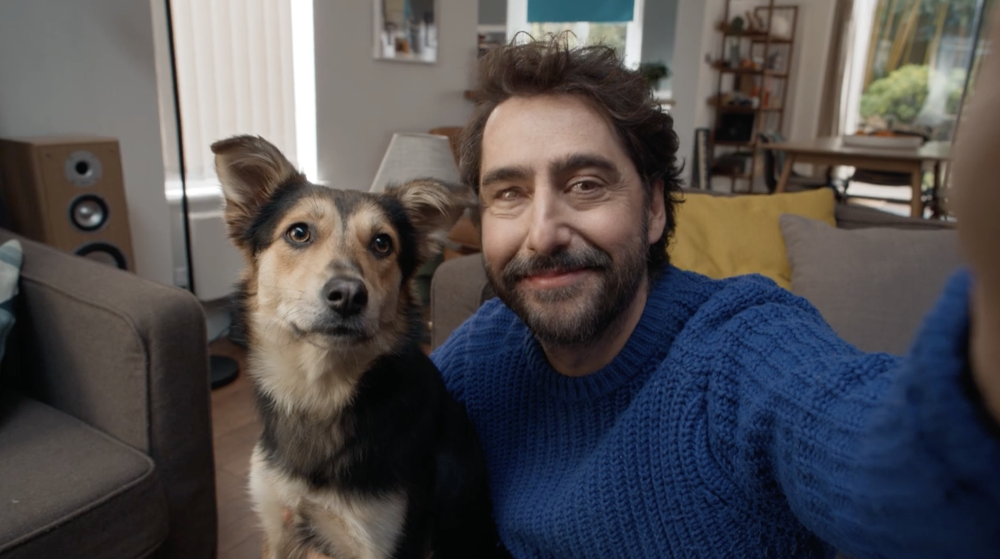

In [23]:
image_file_path = "cloud-samples-data/generative-ai/image/a-man-and-a-dog.png"
image_file_uri = f"gs://{image_file_path}"
image_file_url = f"https://storage.googleapis.com/{image_file_path}"

IPython.display.Image(image_file_url, width=350)

In [24]:
video_file = Part.from_uri(video_file_uri, mime_type="video/mp4")
image_file = Part.from_uri(image_file_uri, mime_type="image/png")

prompt = """
  Look through each frame in the video carefully and answer the questions.
  Only base your answers strictly on what information is available in the video attached.
  Do not make up any information that is not part of the video and do not be too
  verbose, be straightforward.

  Questions:
  - When is the moment in the image happening in the video? Provide a timestamp.
  - What is the context of the moment and what does the narrator say about it?
"""

contents = [video_file, image_file, prompt]

response = multimodal_model.generate_content(contents)
IPython.display.Markdown(response.text)

Okay, here are the answers to your questions:

- **Timestamp:** 0:48 
  - **Context and Narration:** A blind man in a blue sweater takes a selfie with his dog. The narrator states that the story is about a blind man and his girlfriend and follows them on their journey. 

Let me know if you have any other questions about this video! 😊 


### Multimodal E-Commerce



The customer shows you their living room:

|Customer photo |
|:-----:|
|<img src="https://storage.googleapis.com/cloud-samples-data/generative-ai/image/living-room.png" width="50%">  |



Below are four wall art options that the customer is trying to decide between:

|Art 1| Art 2 | Art 3 | Art 4 |
|:-----:|:----:|:-----:|:----:|
| <img src="https://storage.googleapis.com/cloud-samples-data/generative-ai/image/room-art-1.png" width="60%">|<img src="https://storage.googleapis.com/cloud-samples-data/generative-ai/image/room-art-2.png" width="100%">|<img src="https://storage.googleapis.com/cloud-samples-data/generative-ai/image/room-art-3.png" width="60%">|<img src="https://storage.googleapis.com/cloud-samples-data/generative-ai/image/room-art-4.png" width="60%">|


How can you use Gemini 1.5 Pro, a multimodal model, to help the customer choose the best option?

#### Generating Open Reccomendations

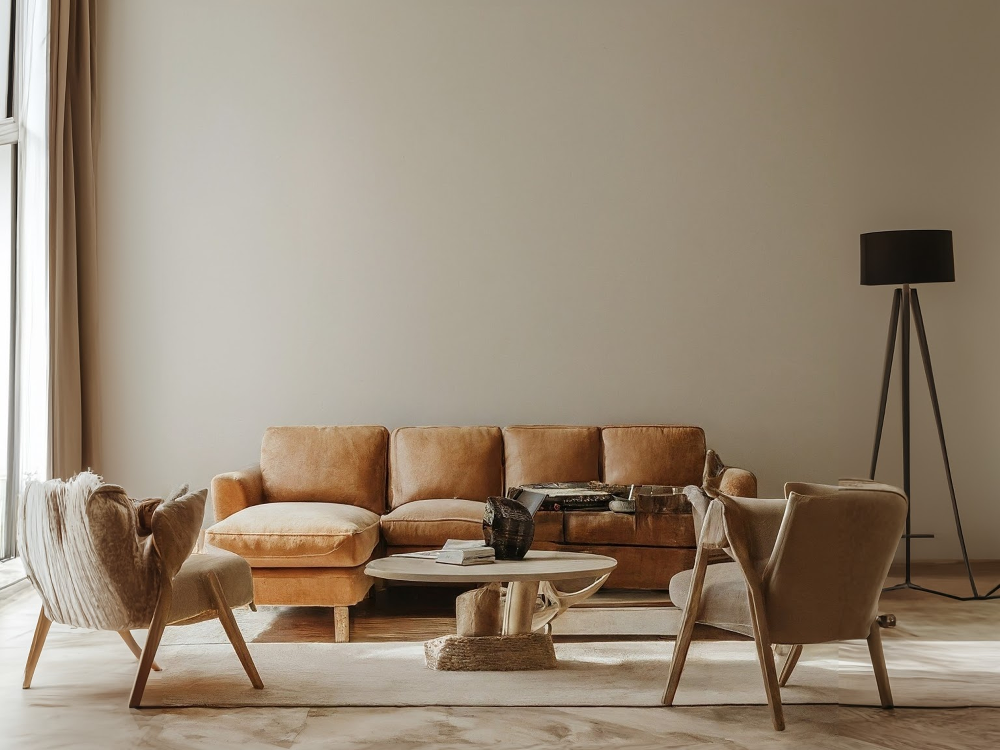

The room is minimally decorated with a neutral color palette.  It features a large, brown leather sectional sofa, a light-colored wood coffee table with a unique base made of natural materials, and two accent chairs with beige upholstery. One accent chair has a more modern, angular design while the other has a more traditional, rounded silhouette. The room is well-lit with natural light from a large window and a black floor lamp with a tripod base provides additional lighting. A beige rug defines the seating area and enhances the overall warmth of the space. The walls are bare, creating a sense of spaciousness and tranquility.  The overall impression of the room is one of casual elegance and comfortable sophistication. 


In [25]:
# urls for room images
room_image_url = "https://storage.googleapis.com/cloud-samples-data/generative-ai/image/living-room.png"

# load room images as Image Objects
room_image = load_image_from_url(room_image_url)

prompt = "Describe this room"
contents = [prompt, room_image]

IPython.display.Image(room_image_url, width=350)
responses = multimodal_model.generate_content(contents)
IPython.display.Markdown(responses.text)

In [26]:
prompt1 = "Recommend a new piece of furniture for this room"
prompt2 = "Explain the reason in detail"
contents = [prompt1, room_image, prompt2]

responses = multimodal_model.generate_content(contents)
IPython.display.Markdown(responses.text)

This room calls for a statement piece that complements the existing furniture and fills the visual space on the right side of the image. I recommend a **large, open bookshelf** for these reasons: 

* **Balance:** The room currently feels a bit weighted to the left with the larger sofa sectional. A bookshelf on the right would create visual balance.
* **Functionality:** A bookshelf adds practical storage, which is always welcome in a living room. It can house books, decorative items, and even baskets for storage. 
* **Style:**  The existing furniture has a natural, organic feel. A bookshelf made of wood or metal with a simple design would complement this aesthetic. Look for pieces with open shelving to maintain the airy feel of the room. 
* **Light:** The right side of the room could benefit from more light. An open bookshelf wouldn't block any natural light from the window, and you could further enhance the space by adding a lamp on one of the shelves.

By choosing a bookshelf that embodies the same warm tones and natural materials present in the existing furniture, you can create a cohesive and inviting living space. 


### Generating recommendations based on provided images

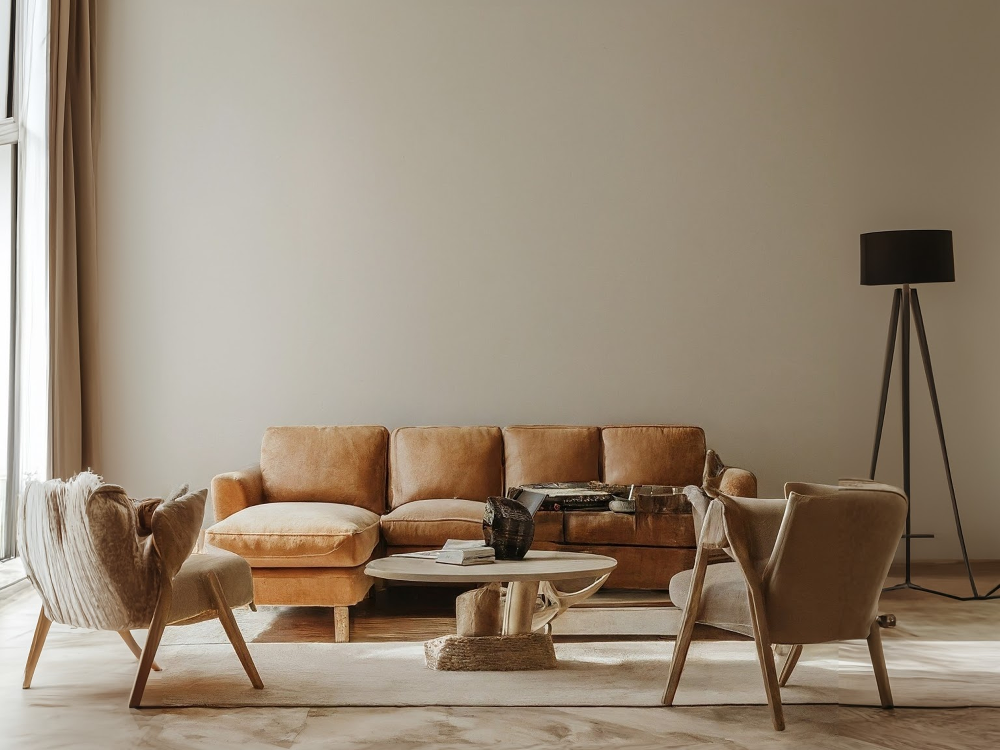


------Art1:-------


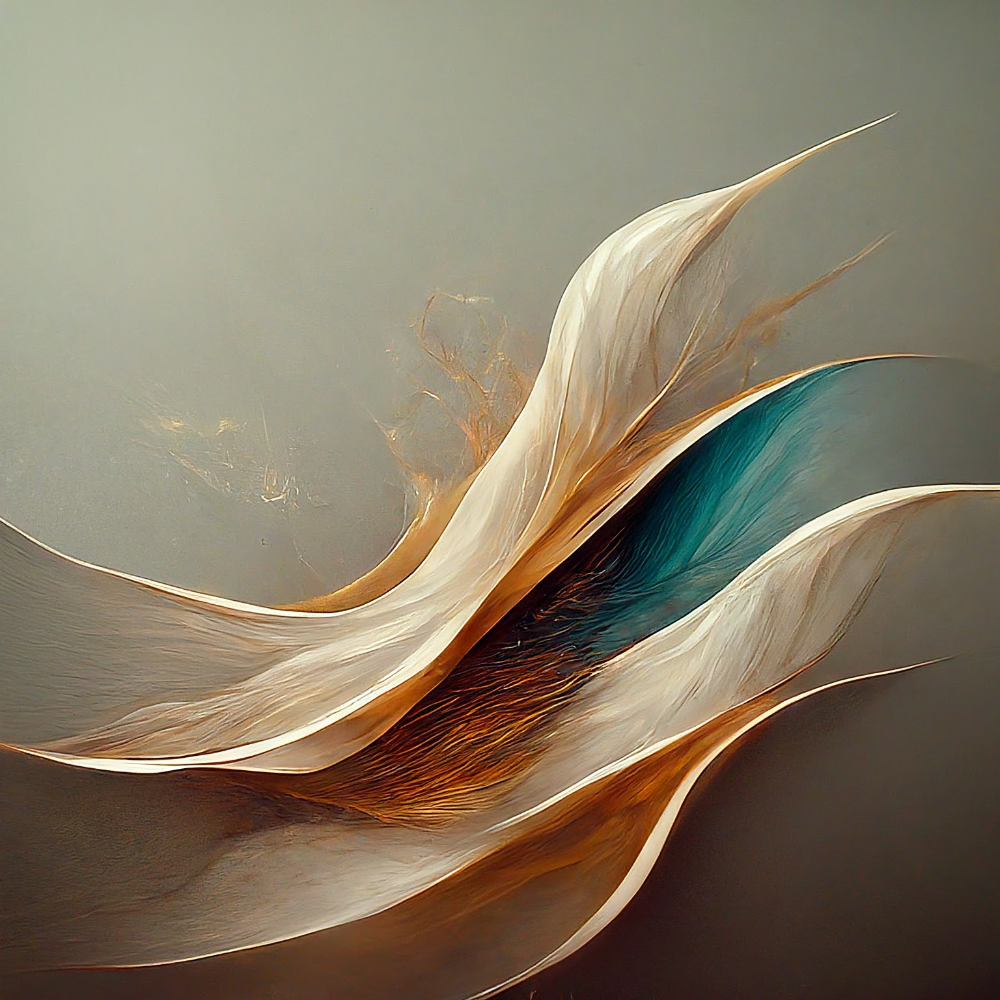


------Art2:-------


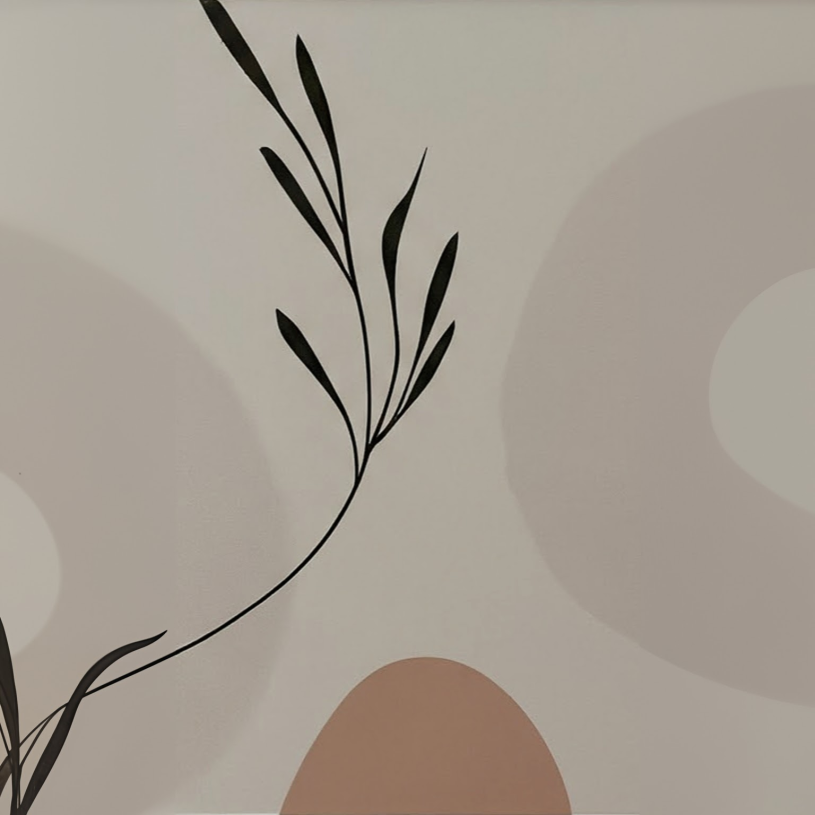


------Art3:-------


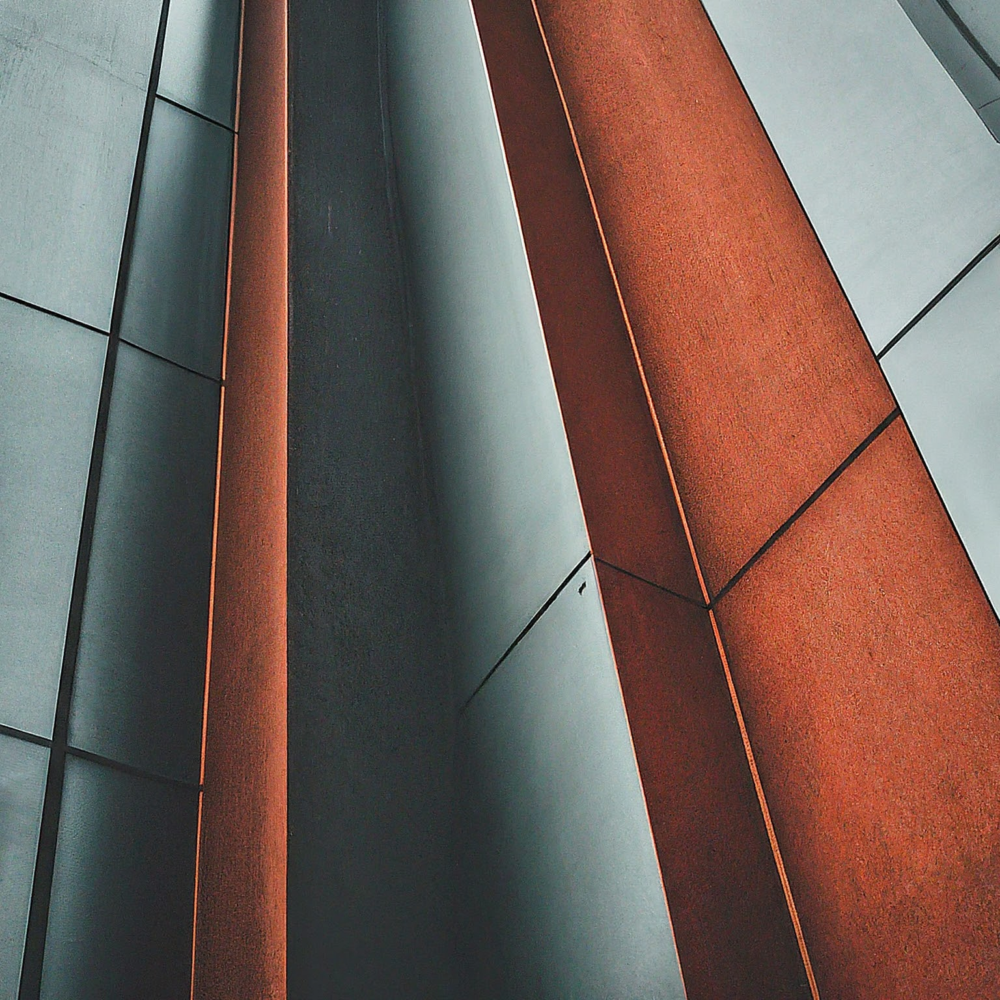


------Art4:-------


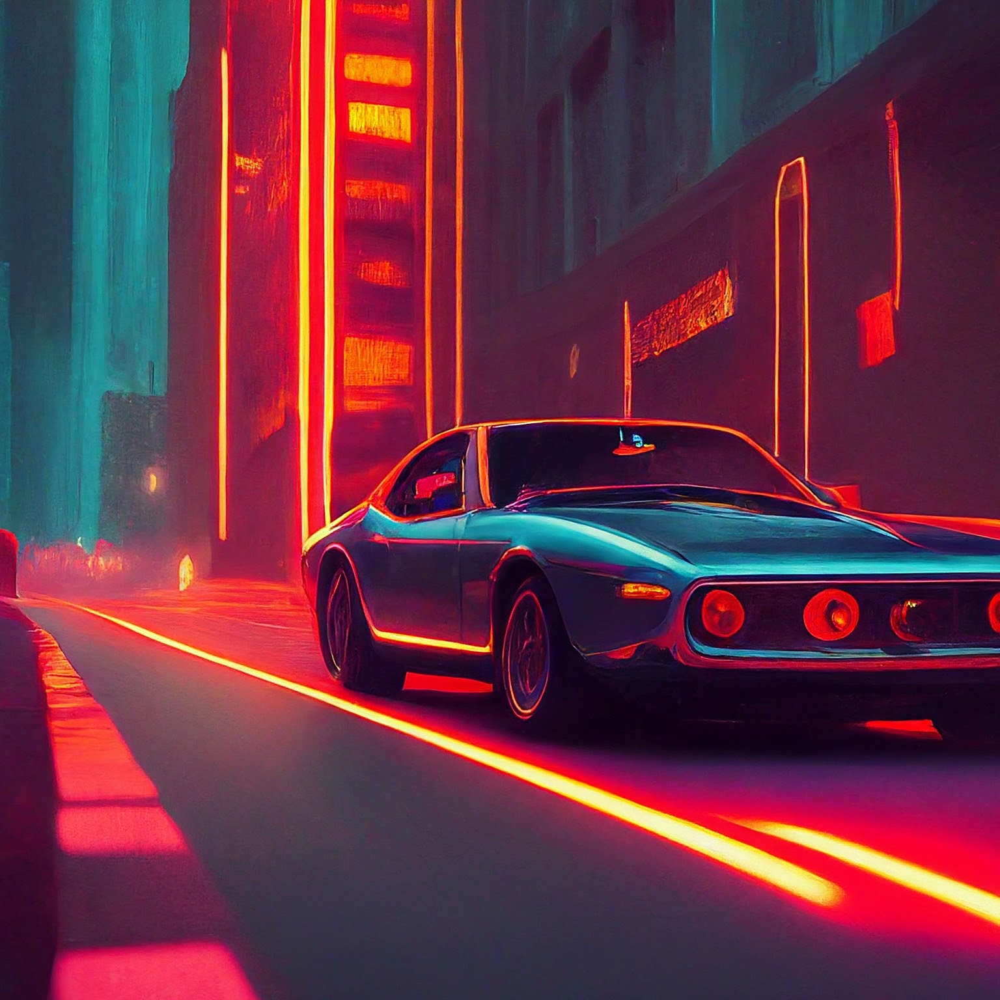

Here's an analysis of each art piece and its compatibility with the room:

**Room Style:** The room exhibits a warm, minimalist aesthetic with a touch of rustic charm. Natural materials, neutral colors, and clean lines dominate the space. 

**Art Analysis & Ranking:**

1. **Art 2 (Botanical Line Art):**  **BEST FIT**
    * **Why it works:**  This piece perfectly embodies the room's aesthetic. The minimalist linework, botanical theme, and neutral color palette blend seamlessly with the existing furniture and color scheme. 
    * **Placement:**  This piece would look stunning above the sofa, adding a touch of visual interest without overwhelming the space. 

2. **Art 1 (Abstract Flowing Forms):** **GOOD FIT**
    * **Why it works:** The artwork's color scheme (browns, golds, teal) complements the room's palette beautifully. The flowing forms add a touch of dynamism while maintaining a sense of calm due to the artwork's abstract nature. 
    * **Placement:** This piece could work well above the sofa or on the wall opposite the window, adding a focal point to the space.

3. **Art 3 (Architectural Lines):** **POTENTIALLY GOOD FIT**
    * **Why it *could* work:** The emphasis on clean lines and geometric shapes echoes the room's minimalist tendencies. The color palette, while a bit cooler, could complement the room if other warmer accents are incorporated.
    * **Why it *might not* work:**  The industrial feel of the image might clash with the overall warmth and organic feel of the room.
    * **Placement:** If used, this piece would be best on a smaller wall to avoid feeling too imposing.

4. **Art 4 (Neon Cityscape):** **LEAST FITTING**
    * **Why it doesn't work:** The vibrant neon colors, retro-futuristic theme, and energetic composition clash significantly with the room's serene and natural ambiance. 
    * **Placement:** This piece is too visually busy and thematically different to fit comfortably within this room's design. 


In [27]:
# Download and display sample artwork
art_image_urls = [
    "https://storage.googleapis.com/cloud-samples-data/generative-ai/image/room-art-1.png",
    "https://storage.googleapis.com/cloud-samples-data/generative-ai/image/room-art-2.png",
    "https://storage.googleapis.com/cloud-samples-data/generative-ai/image/room-art-3.png",
    "https://storage.googleapis.com/cloud-samples-data/generative-ai/image/room-art-4.png",
]

# Load wall art images as Image Objects
art_images = [load_image_from_url(url) for url in art_image_urls]

# To recommend an item from a selection, you will need to label the item number within the prompt.
# That way you are providing the model with a way to reference each image as you pose a question.
# Labeling images within your prompt also helps reduce hallucinations and produce better results.
prompt = """
  You are an interior designer.
  For each piece of wall art, explain whether it would be appropriate for the style of the room.
  Rank each piece according to how well it would be compatible in the room.
"""
contents = [
    "Consider the following art pieces:",
    "art 1:",
    art_images[0],
    "art 2:",
    art_images[1],
    "art 3:",
    art_images[2],
    "art 4:",
    art_images[3],
    "room:",
    room_image,
    prompt,
]

IPython.display.Image(room_image_url, width=350)
print("\n------Art1:-------")
IPython.display.Image(art_image_urls[0], width=150)
print("\n------Art2:-------")
IPython.display.Image(art_image_urls[1], width=150)
print("\n------Art3:-------")
IPython.display.Image(art_image_urls[2], width=150)
print("\n------Art4:-------")
IPython.display.Image(art_image_urls[3], width=150)

responses = multimodal_model.generate_content(contents)
IPython.display.Markdown(responses.text)

### Mistakes

In [29]:
from langchain.llms import GPT4All
from langchain import PromptTemplate, LLMChain

# create a prompt template where it contains some initial instructions
# here we say our LLM to think step by step and give the answer

template = """
Let's think step by step of the question: {question}
Based on all the thought the final answer becomes:
"""
prompt = PromptTemplate(template=template, input_variables=["question"])

local_path = ("/home/mb600l/conda_env/models/Meta-Llama-3-8B-Instruct.Q4_0.gguf")

# initialize the LLM and make chain it with the prompts
llm = GPT4All(model=local_path, device='gpu') # device='amd', device='intel'
llm_chain = prompt | llm

# run the chain with your query (question)
print(llm_chain.invoke({"question": 'Who is the CEO of Google and why he became the ceo of Google?'}))

Sundar Pichai, an Indian-American business executive, has been serving as the Chief Executive Officer (CEO) of Alphabet Inc., the parent company of Google, since December 2019. He was appointed CEO after Larry Page stepped down from the role.

Before becoming the CEO of Google, Sundar worked at Google for over a decade and held various leadership positions within the company. In 2004, he joined Google as an engineer in their New York office. Over time, he rose through the ranks to become Vice President of Android Development (2013-2015), then Senior Vice President of Chrome Operating System and Android (2015-2018). He was also responsible for overseeing Google's product portfolio.

Sundar became CEO after Larry Page stepped down from the role in December 2019. Prior to that, he had been serving as the CEO of Google Cloud since March 2018. As CEO, Sundar has focused on driving innovation and growth within Alphabet Inc., while also prioritizing diversity, equity, and inclusion initiative

In [31]:
from langchain.llms import GPT4All
from langchain import PromptTemplate, LLMChain

# create a prompt template where it contains some initial instructions
# here we say our LLM to think step by step and give the answer

template = """
Let's think step by step of the question: {question}
Based on all the thought the final answer becomes:
"""
prompt = PromptTemplate(template=template, input_variables=["question"])
local_path = ("/home/mb600l/conda_env/models/llama-3.2-1b-instruct-q8_0.gguf")

# initialize the LLM and make chain it with the prompts
llm = GPT4All(model=local_path, device='gpu') # device='amd', device='intel'
llm_chain = prompt | llm

# run the chain with your query (question)
print(llm_chain.invoke({"question": 'Who is the CEO of Google and why he became the ceo of Google?'}))

Larry Page

Explanation:

The best answer is Larry Page.


# Simple RAG

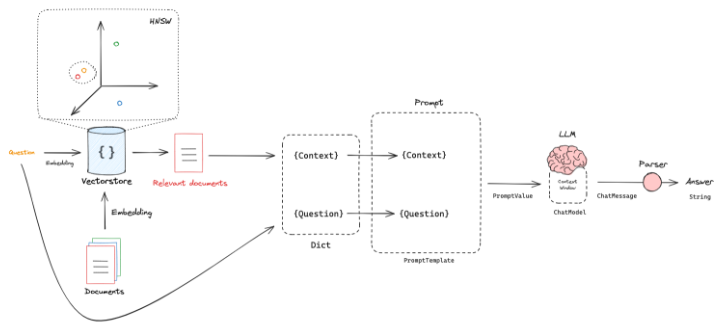

In [28]:
import bs4
from langchain import hub
from langchain.text_splitter import RecursiveCharacterTextSplitter
from langchain_community.document_loaders import WebBaseLoader
from langchain_community.vectorstores import Chroma
from langchain_core.output_parsers import StrOutputParser
from langchain_core.runnables import RunnablePassthrough
from langchain_openai import ChatOpenAI, OpenAIEmbeddings

#### INDEXING ####

# Load Documents
loader = WebBaseLoader(
    web_paths=("https://lilianweng.github.io/posts/2023-06-23-agent/",),
    bs_kwargs=dict(
        parse_only=bs4.SoupStrainer(
            class_=("post-content", "post-title", "post-header")
        )
    ),
)
docs = loader.load()

# Split
text_splitter = RecursiveCharacterTextSplitter(chunk_size=1000, chunk_overlap=200)
splits = text_splitter.split_documents(docs)

# Embed
vectorstore = Chroma.from_documents(documents=splits, 
                                    embedding=OpenAIEmbeddings())

retriever = vectorstore.as_retriever()

#### RETRIEVAL and GENERATION ####

# Prompt
prompt = hub.pull("rlm/rag-prompt")

# LLM
llm = ChatOpenAI(model_name="gpt-3.5-turbo", temperature=0)

# Post-processing
def format_docs(docs):
    return "\n\n".join(doc.page_content for doc in docs)

# Chain
rag_chain = (
    {"context": retriever | format_docs, "question": RunnablePassthrough()}
    | prompt
    | llm
    | StrOutputParser()
)

# Question
rag_chain.invoke("What is Task Decomposition?")

'Task Decomposition is a technique used to break down complex tasks into smaller and simpler steps. This approach helps agents to plan ahead and tackle difficult tasks more effectively. Task decomposition can be done through various methods, including using prompting techniques, task-specific instructions, or human inputs.'